# Stochastic Prediction Model, <br><small>Case of Dengue Outbreak in Tainan, 2015</small>

## Part 1

### Data Cleaning and Visualization

Data 
---
- [Tainan Goverment](http://data.tainan.gov.tw/dataset/denguefevercases): cases data

- [Tainan Goverment](http://data.tainan.gov.tw/dataset/2015-df-mosquito-density): density of vector masquitos




Note
---
- vector mosquito: Aedes aegypt (埃及斑蚊), Aedes albopictus（及白線斑蚊）
- Breteau Index (布氏指數): KaoKsuing<br>
    ```布氏指數=8.349×誘蚊產卵器陽性率+4.972```

- This data is recorded in *big5* encoding and have to converted into **utf-8** in advanced. The worse, data are partly in **big5** encoding and partly in **utf-8** encoding.
  - Libreoffice:
    
    ```
    [Save As:] ...
    
    File type: Text csv(.csv)
      √ automatic file extensions
      √ Edit file setting
      
    --------------------
            Use TeXt CSV Format                    
    --------------------
    
    Character set: Unicode (UTF 8)
    ```
  - iconv   
    ```shell
    > iconv -c -t utf8 data.csv > data_utf8.csv
    ```
- Also change the names of column in English    

In [4]:
from IPython.core.display import HTML
import qgrid
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import gmplot,folium
import seaborn as sns
from ipywidgets import interact,widgets,interactive
from IPython.display import display,clear_output
import warnings
warnings.filterwarnings('ignore')

sns.set()

%matplotlib inline

Eco Systems Info
---
Requirements, by `pip`:
- **gmap**, package which helps to render data on the Google map; the bad news of using Google map, it not fully free. Using Google map, you need to get a API key and link with your billing card info. Or try the next solution:
- **folium**, folium builds on the data wrangling strengths of the Python ecosystem and the mapping strengths of the Leaflet.js library. Manipulate your data in Python, then visualize it in a Leaflet map via folium.
- **statmodels**, a Python package provides statistical utilities;
- **arch**, Autoregressive Conditional Heteroskedasticity (ARCH) avails tools for time-series,

What packages we used,

In [1]:
%load_ext watermark

In [2]:
%watermark -a "" -v -p numpy,scipy,seaborn,pandas,qgrid,ipywidgets,arch,statsmodels,gmplot,folium,matplotlib,notebook

CPython 3.6.5
IPython 7.3.0

numpy 1.16.1
scipy 1.2.1
seaborn 0.9.0
pandas 0.24.1
qgrid 1.1.1
ipywidgets 7.4.2
arch 4.7.0
statsmodels 0.9.0
gmplot n
folium 0.8.2
matplotlib 3.0.2
notebook 5.7.5


In [8]:
import sys
pd.options.display.encoding = sys.stdout.encoding

In [5]:
qgrid.set_defaults( precision=4)

Data Sources
---
<a href="http://data.tainan.gov.tw/dataset/dengue-dist">Tainan City Government</a>

Subjects
---

Load native data,

In [6]:
df = pd.DataFrame.from_csv('data/test.csv',index_col=0,parse_dates=[0],encoding="utf-8")
#df = df.sort_index()
#result = df.sort(['A', 'B'], ascending=[1, 0])


In [7]:
qgrid.show_grid(df)

QgridWidget(grid_options={'fullWidthRows': True, 'syncColumnCellResize': True, 'forceFitColumns': True, 'defau…

In [7]:
#convert Date format from YY/MM/DD to YY-MM-DD
df['date']=pd.to_datetime(df['date'])

# before we accumulate the number of suspectives at each day, we add a new colume, num=1
df['num']=1

In [23]:
df.tail()

,date,district,alley,street,longitude,latitude,num
index,,,,,,,
9,2016-01-08,永康區,鹽洲里,洲尾街,23.042,120.229,1
10,2016-01-13,北區,興南里,公園南路,23.001,120.208,1
11,2016-01-13,安平區,億載里,平豐路,22.992,120.163,1
12,2016-01-18,東區,莊敬里,中華東路,22.998,120.234,1
13,2016-01-20,龍崎區,龍船里,龍船里,22.948,120.421,1


In [ ]:
import folium
#from folium.element import IFrame
from folium.plugins import MarkerCluster,CirclePattern

In [9]:
lats1=df['latitude'].values
lons1=df['longitude'].values
locations1 = list(zip(lons1, lats1))

dates1=df['date'].dt.strftime('%Y-%m-%d')
dates2=dates1.values

In [10]:
Tainan_COORDINATES = ( df['longitude'].mean(), df['latitude'].mean()) 

map = folium.Map(location=Tainan_COORDINATES, 
                 zoom_start=10)
map.add_children(MarkerCluster(locations=locations1, popups=dates2))

In [11]:
#display(map)
map.save('Taiwanfolium.html')

In [18]:
cases=df[['date','num','district']]
cases.tail(3)

,date,num,district
index,,,
11,2016-01-13,1,安平區
12,2016-01-18,1,東區
13,2016-01-20,1,龍崎區


To let qgrid work again (with ipywidget-6.0.0+), change
```
qgrid.show_grid(df) 
  ⬇︎
qgrid.show_grid(df,show_toolbar=True, grid_options={'forceFitColumns': False, 'defaultColumnWidth': 200})

```
Also, new Jupyter notebook limits the iopub data rate; enlarge the rate in configuration, 
**jupyter_notebook_config.py*** as follows:
```
NotebookApp.iopub_data_rate_limit=10000000000
```

Note
---
Fast development of ipywidgets provides much advantages of data display, flexibility, interactivity on browser; disavantge due to its update rate also affect the the third-parckages: **qgrid-0.3.2** can't work since IPython > 6!

<del>qqrid 0-3.3</del> 
---
Solved,
1. modify $anaconda/etc/jupyter/nbconfig/notebook.json as follows:
```
{
  "load_extensions": {
     ...
     "qgrid/qgridjs/qgrid.widget": true
   }
}
```

- make share qgrid had been copy to $Anaconda/share/jupyter/nbextensions as named qgrid (not qgridjs) after executing
```
shell> nbextension install qgrid --sys-prefix
shell> nbextension enable qgrid --sys-prefix
```
   

In [38]:
qgrid.show_grid(df,show_toolbar=True, grid_options={'forceFitColumns': False, 'defaultColumnWidth': 100})


QgridWidget(grid_options={'fullWidthRows': True, 'syncColumnCellResize': True, 'forceFitColumns': False, 'defa…

In [21]:
qgrid.show_grid(df)

QgridWidget(grid_options={'fullWidthRows': True, 'syncColumnCellResize': True, 'forceFitColumns': True, 'defau…

Accumulation numbers of cases:
--

Make the accumulated sum based on date:

In [21]:
#  grouped data with respect to the date
cases_group = cases.groupby('date');
#cases_group.size()

In [23]:
# calculate the accumulated number of cases

cases_totals = cases_group.sum()
#cases_totals.sort(columns='num').head()
cases_totals.tail()

,num
date,
2016-01-06,1
2016-01-08,1
2016-01-13,2
2016-01-18,1
2016-01-20,1


First eys on Data Visualization
---

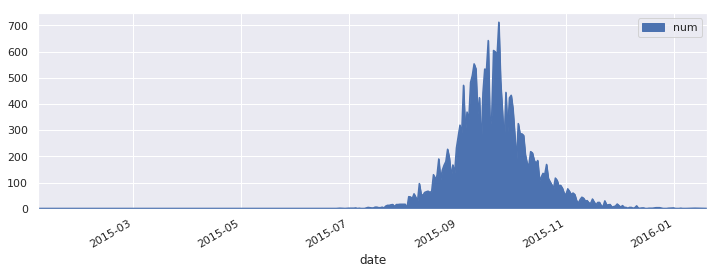

In [24]:

my_plot = cases_totals.plot(kind='area',figsize=[12,4])

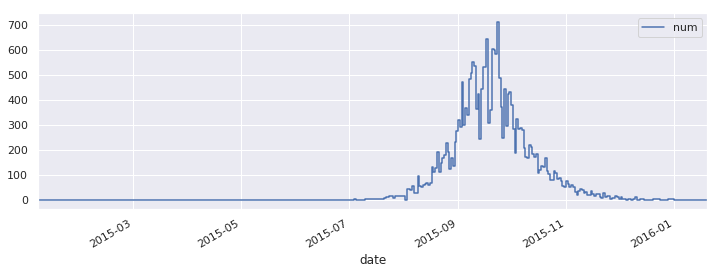

In [25]:
# or this one is better
my_plot = cases_totals.plot(drawstyle='steps',figsize=[12,4])

In [28]:
#  grouped data with respect to the date and district
cases_group1 = cases.groupby(['date','district']);
cases_1 = cases.groupby(['date','district'])[['num']].sum();

# districts' names
#print(cases_1.index[2][:])

In [29]:
# retrieve sequences of district names of data data
district=df.district.tolist()
ndistrict=set(district)

print(ndistrict)

{'大內區', '中西區', '學甲區', '安平區', '新化區', '安南區', '將軍區', '左鎮區', '新營區', '山上區', '官田區', '後壁區', '佳里區', '龍崎區', '新市區', '安定區', '北區', '歸仁區', '東區', '下營區', '東山區', '永康區', '永康區 ', '玉井區', '白河區', '麻豆區', '關廟區', '柳營區', '鹽水區', '楠西區', '西港區', '南區', '六甲區', '仁德區', '善化區', '南化區', '七股區'}


In [26]:
from matplotlib.font_manager import FontProperties
#myFont = FontProperties('/Users/cch/Downloads/kaiu.ttf')
# change font for Traditional Chinese Language
plt.rcParams['font.sans-serif'] = ['LiHei Pro']
plt.rcParams['font.size']=18

myFont = FontProperties('AR PL New Kai')
font_chinese = FontProperties(fname="/Users/cch/Documents/2017/jeibaChinese/fireflysung.ttf")

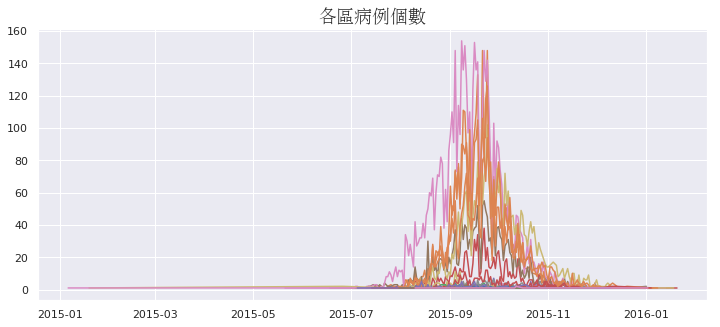

In [30]:
#plt.rcParams['axes.unicode_minus'] = False
ndistrict=list(ndistrict)

kind=0
plt.figure(figsize=(12,5))
for k in ndistrict:
    plt.plot(cases_1.xs(k,level='district'),label=k)
    #plt.legend(k)
    plt.title(u"各區病例個數",fontsize=30,fontproperties = font_chinese)
    kind=kind+1 

In [31]:
# define dropdown options
w = widgets.Dropdown(
    options=ndistrict,
    value=ndistrict[9],
    description='District:',
)

# make plot for selected district

def plot_district_case(district_area):   
    plt.rcParams['font.family'] = 'AppleGothic' 
    plt.figure(figsize=(12,6))
    plt.plot(cases_1.xs(district_area,level='district'),drawstyle='steps')
    #plt.legend(k)
    plt.title(district_area+" 病例",fontproperties = font_chinese) ;
    #plt.ylim([1,160])
    plt.xticks(rotation=90)
    clear_output(True)
    
    

In [32]:
import plotly.plotly as py
from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go
import cufflinks
# offline mode
cufflinks.go_offline()
# Set the global theme for cufflinks
cufflinks.set_config_file(world_readable=True, theme='pearl', offline=True)

In [33]:
def plotly_district_case(district_area):   
    case_size=len(cases_1.xs(district_area,level='district'))

    title_= district_area+' 病例個數'
    cases_1.xs(district_area,level='district').iplot(title=title_, xTitle='Date, 日期',yTitle='Numbers of cases, 病例數目')
    clear_output(True)

In [34]:
tool=interact(plot_district_case, district_area=w);
display(tool)

interactive(children=(Dropdown(description='District:', index=9, options=('大內區', '中西區', '學甲區', '安平區', '新化區', '…

<function __main__.plot_district_case(district_area)>

In [35]:
tool=interact(plotly_district_case, district_area=w);
display(tool)

interactive(children=(Dropdown(description='District:', index=18, options=('大內區', '中西區', '學甲區', '安平區', '新化區', …

<function __main__.plotly_district_case(district_area)>

Mosquitos Data
---

In [42]:
df_mosquito2 = pd.DataFrame.from_csv('data/mosquito-re1.csv',index_col=['date'],encoding="utf-8")

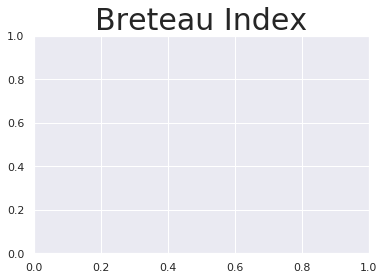

In [49]:
# Native data seems worse to display with un-ordered dates
for DistName in ndistrict:
    #plt.plot(df_mosquito2.xs(k,level='district'),label=k)
    #print(DistName)
    if DistName!='永康區':
       df_mosquito2[df_mosquito2['district']==DistName]['BIndex'].iplot(title=DistName)
    else:
       df_mosquito2[df_mosquito2['district']=='永康區']['BIndex'].iplot()
    #plt.legend(k)
    #plt.title("Breteau Index",fontsize=30)#,fontproperties = myFont)

In [57]:
# Sored by date-index but comes a little fuzzy
for DistName in ndistrict:    
    df_mosquito2[df_mosquito2['district']==DistName]['BIndex'].sort_index().iplot(title=DistName)
    

In [106]:
layout1 = cufflinks.Layout(
    title='BIndex',
    height=250,
    width=800
)
layout2 = cufflinks.Layout(
    title='病例個數',
    height=300,
    width=800
)
# Let's classify out by help of ipywidgets again
def plotly_BIndex(district_area):
    title_= district_area+' BIndex'
    p1=df_mosquito2[df_mosquito2['district']==district_area]['BIndex'].sort_index().iplot(title=title_,layout=layout1.to_plotly_json())
    
    case_size=len(cases_1.xs(district_area,level='district'))

    title2_= district_area+' 病例個數'
    p2=cases_1.xs(district_area,level='district').iplot(title=title2_, xTitle='Date, 日期',yTitle='Numbers of cases, 病例數目',layout=layout2.to_plotly_json())

    clear_output(True)

In [107]:
tool=interact(plotly_BIndex, district_area=w);
display(tool)

interactive(children=(Dropdown(description='District:', index=16, options=('大內區', '中西區', '學甲區', '安平區', '新化區', …

<function __main__.plotly_BIndex(district_area)>

Binding togeter
---
Place these two subplots in a scece,

In [108]:
import plotly.plotly as py
from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go

In [120]:
# look at the infected case dataframe
district_area='永康區'
df_mos=df_mosquito2[df_mosquito2['district']==district_area].sort_index()

In [122]:
df_mos[:5]

,index,district,BIndex
date,,,
2015-01-12,28,永康區,0.0
2015-01-13,45,永康區,0.0
2015-01-15,64,永康區,0.0
2015-01-16,75,永康區,0.0
2015-01-21,113,永康區,0.0


In [134]:
# and the Bindex dataframe, only one feature
p2=cases_1.xs(district_area,level='district')
p2.head()

,num
date,
2015-07-12,1
2015-07-13,1
2015-07-18,1
2015-07-27,1
2015-07-28,2


Now Let's to implement the figure which puts *infected* dataframe and *BIndex* dataframe together
```
Fill all □⃞□⃞□⃞□⃞□⃞ to complete the output, like the last figure:
```

In [138]:
def plotly_BIndex_num(district_area):
    title_= district_area+' 病例個數, BIndex'
    df_mos=df_mosquito2[df_mosquito2['district']==district_area].sort_index()
    p2=cases_1.xs(district_area,level='district')
    
    trace_mosquitos = go.Scatter(
                x=df_mos.□⃞□⃞□⃞□⃞□⃞,
                y=df_mos.□⃞□⃞□⃞□⃞□⃞,
                name = "BIndex",
                line = dict(color = '#17BECF'),
                opacity = 0.8)
    trace_cases=go.Scatter(
                x=p2.□⃞□⃞□⃞□⃞□⃞,
                y=p2.□⃞□⃞□⃞□⃞□⃞,
                name =' 病例個數',
                line = dict(color = '#7F7F7F'),
                opacity = 0.8)
    data = [trace_mosquitos,trace_cases]
    
    layout = dict(
                  title = title_,
                  # add slider function on data selection
                  xaxis=dict(
                             rangeselector=dict(
                                  buttons=list([
                                          dict(count=1,label='1m',step='month',stepmode='backward'),
                                          dict(count=3,label='3m',step='month',stepmode='backward'),
                                          dict(step='all')
                                  ])
                              ),
                              rangeslider=dict(visible = True),
                              type='date'
                  )
             )
    fig = go.Figure(data=data, layout=layout)
    iplot(fig, filename = "Infected_Cases_and_BIndex")
    clear_output(True)

In [139]:
tool2=interact(plotly_BIndex_num, district_area=w);
display(tool2)

interactive(children=(Dropdown(description='District:', index=18, options=('大內區', '中西區', '學甲區', '安平區', '新化區', …

<function __main__.plotly_BIndex_num(district_area)>

In [128]:
trace_mosquitos = go.Scatter(
                x=df_mos.□⃞□⃞□⃞□⃞□⃞,
                y=df_mos.□⃞□⃞□⃞□⃞□⃞,
                name = "BIndex",
                line = dict(color = '#17BECF'),
                opacity = 0.8)
trace_cases=go.Scatter(
                x=p2.□⃞□⃞□⃞□⃞□⃞,
                y=p2.□⃞□⃞□⃞□⃞□⃞,
                name = "affected number",
                line = dict(color = '#7F7F7F'),
                opacity = 0.8)
data = [trace_mosquitos,trace_cases]

layout = dict(
    title = "Infexted Cases and Bindex",
    #xaxis = dict(
    #range = ['2016-07-01','2016-12-31'])
)

fig = go.Figure(data=data, layout=layout)
iplot(fig, filename = "Manually Set Range")